In [1]:
%matplotlib inline

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import scipy

from matplotlib import animation, rc
from IPython.display import HTML
rc('animation', html='jshtml')
import seaborn as sns

#Define plotting style:
sns.set() #Set style
sns.set_style('ticks',{'font.family':'serif', 'font.serif':'Times New Roman'})
sns.set_style('ticks',{'font.family':'serif', 'font.serif':'Times New Roman'})
sns.set_context('paper', font_scale=1.8,  rc={"lines.linewidth": 3})
sns.set_palette(sns.color_palette("deep"))

### Modelo Classico (oscilador harmônico + força de dissipação)

In [3]:
def E(t,E0,w):
    return E0*np.cos(w*t)

def RHS(xV,t,m,w0,n,e,w,E0):
    return (xV[1],-w0**2*xV[0] - (n/m)*xV[1] -e*E(t,E0,w))
    

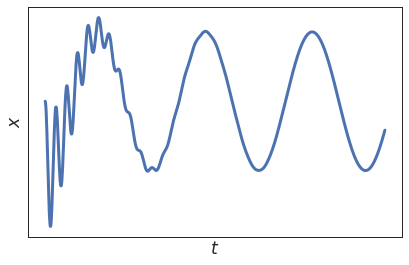

In [4]:
#Constantes em unidades arbitrárias:
m = 1.0 #massa
w0 = 0.1 #frequência do oscilador
k = m*w0**2 #constante elástica
n = 0.01 #constante dissipativa
e = 1 #carga elétrica
E0 = 1e-3 # amplitude do campo elétrico

w = w0/10 # frequência do campo elétrico
#Condicoes iniciais:
x0 = [0,0]
t = np.linspace(0,2000,1000)
xV_sol = scipy.integrate.odeint(RHS,x0,t,args=(m,w0,n,e,w,E0))
x_sol = xV_sol[:,0]

#Função analítica para o limite onde x(t=0) = xmax
@np.vectorize
def x_ana(t,e,E0,m,w0,w):
    xmax = (-e*E0/m)*1/(w0**2-w**2)
    return xmax*np.cos(w*t)
    

fig = plt.figure(figsize=(6,4))
plt.plot(t,x_sol)
# plt.hlines(y=max(x_sol),xmin=min(t),xmax=max(t),linestyle='--')
# plt.hlines(y= abs((e*E0/m)*1/(w0**2-w**2)),xmin=min(t),xmax=max(t),linestyle='-.')
# plt.plot(t,x_ana(t,e=e,E0=E0,m=m,w0=w0,w=w),'--')
plt.xlabel(r'$t$')
plt.ylabel(r'$x$')
plt.xticks([])
plt.yticks([])
plt.tight_layout()
plt.savefig('fotoeletricoClassico1.pdf')
plt.show()

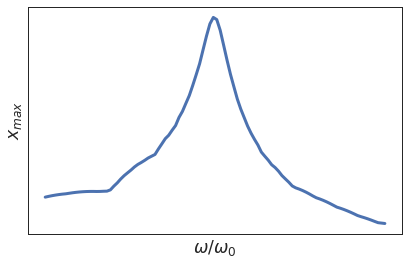

In [5]:
#Constantes em unidades arbitrárias:

wList = np.linspace(w0/2,1.5*w0,100) # frequência do campo elétrico
xmax = []
#Condicoes iniciais:
x0 = [0,0]
t = np.linspace(0,3000,1000)
for w in wList:
    xV_sol = scipy.integrate.odeint(RHS,x0,t,args=(m,w0,n,e,w,E0))
    x_sol = xV_sol[:,0]
    xmax.append(max(x_sol))
    

fig = plt.figure(figsize=(6,4))
plt.plot(wList/w0,xmax)
plt.xlabel(r'$\omega/\omega_0$')
plt.ylabel(r'$x_{max}$')
plt.xticks([])
plt.yticks([])
plt.tight_layout()
plt.savefig('fotoeletricoClassico2.pdf')
plt.show()

In [6]:
w = w0/5 # frequência do campo elétrico
#Condicoes iniciais:
x0 = [0,0]
t = np.linspace(0,1000,1000)
xV_solA = scipy.integrate.odeint(RHS,x0,t,args=(m,w0,n,e,w,E0))
x_solA = xV_solA[:,0]
labelA = r'$\omega/\omega_0 = %1.1f$' %(w/w0)

In [7]:
#Constantes em unidades arbitrárias:
w = w0 # frequência do campo elétrico
#Condicoes iniciais:
x0 = [0,0]
t = np.linspace(0,1000,1000)
xV_solB = scipy.integrate.odeint(RHS,x0,t,args=(m,w0,n,e,w,E0))
x_solB = xV_solB[:,0]
labelB = r'$\omega/\omega_0 = %1.1f$' %(w/w0)

In [8]:
#Constantes em unidades arbitrárias:
w = 5*w0 # frequência do campo elétrico
#Condicoes iniciais:
x0 = [0,0]
t = np.linspace(0,1000,1000)
xV_solC = scipy.integrate.odeint(RHS,x0,t,args=(m,w0,n,e,w,E0))
x_solC = xV_solC[:,0]
labelC = r'$\omega/\omega_0 = %1.1f$' %(w/w0)

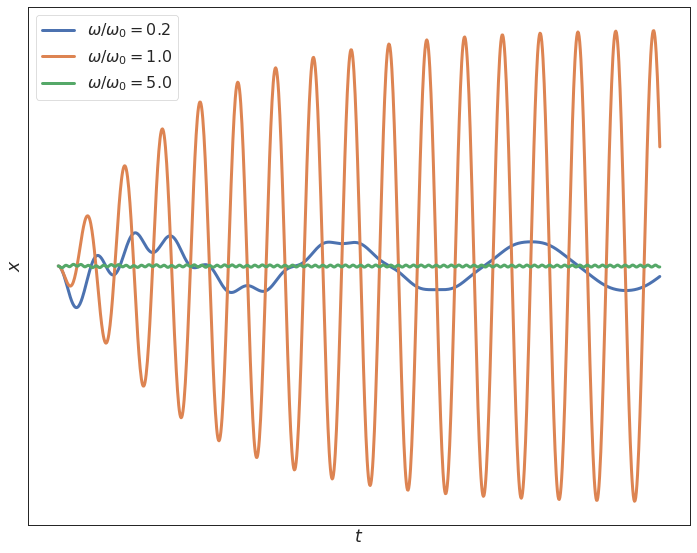

In [9]:
fig = plt.figure(figsize=(10,8))
plt.plot(t,x_solA,label=labelA)
plt.plot(t,x_solB,label=labelB)
plt.plot(t,x_solC,label=labelC)
plt.xlabel(r'$t$')
plt.ylabel(r'$x$')
plt.xticks([])
plt.yticks([])
plt.legend()
plt.tight_layout()
plt.savefig('fotoeletricoClassico3.pdf')
plt.savefig('fotoeletricoClassico3.png')
plt.show()

### Animacao

In [14]:
tmin, tmax = 0,1000 #Tempo inicial e final
dt = 2.0 #Intervalo de tempo
npts = 1000 #Numero de pontos
tpts = np.linspace(tmin,tmax,npts)

#Solução:
w = w0 # frequência do campo elétrico
#Condicoes iniciais:
x0 = [0,0]
xV_sol = scipy.integrate.odeint(RHS,x0,tpts,args=(m,w0,n,e,w,E0))
x_sol = xV_sol[:,0]
xmin,xmax = min(x_sol),max(x_sol)
xF = scipy.interpolate.interp1d(tpts,x_sol)

In [15]:
fig = plt.figure(figsize=(22,7))
ax1 = plt.subplot(121)
pt, = ax1.plot([0.,xF(tmin)],'o',markersize=25)
epts = np.linspace(-0.1,0.1)
Efield, = ax1.plot(epts,np.cos(w*0 - epts/w),linewidth=3,color='orange',alpha=0.8)
line, = ax1.plot([0.,0.],[0.,xF(tmin)],'--')
textA = ax1.text((xmax+xmin)/2, 0.09, r'$x=%2.3f$ m' %xF(tmin),fontsize=20)
xlabel = ax1.set_ylabel('x',fontsize=40)
ax1.set_ylim(xmin,xmax)
ax1.set_xlim(-0.1,0.1)
ax1.set_yticks([])
ax1.set_xticks([])

ax2 = plt.subplot(122)
Kl, = ax2.plot(tpts,xF(tpts),linewidth=4.0)
xlabel = ax2.set_xlabel('t (s)',fontsize=40)
ax2.legend(['x'],loc='upper right',framealpha=1.0,fontsize=25.0)
ax2.set_yticks([])
ax2.set_xticks([])


def init():
    tpts = [tmin]
    pt.set_data([[0.],xF(tmin)])
    line.set_data([0.,0.],[0.,xF(tmin)])
    line._linewidth = 3.0
    Kl.set_data(tpts,xF(tpts))
    Efield.set_data(epts,np.cos(w*tmin - epts/w))
    textA.set_text(r'$x=%2.3f$ m' %xF(tmin))
    return (pt,line,Kl,textA,Efield)

def animate(i):
    
    tA = tmin+i*dt
    tpts = np.linspace(tmin,tA,100)
    xpt = [xF(tA)]
    ypt = [0.]
    pt.set_data(ypt,xpt)
    line.set_data([0.,0.],[0.,xF(tA)])
    line._linewidth = 3.0/(0.1+abs(xF(tA))/2.)
    Kl.set_data(tpts,xF(tpts))
    Efield.set_data(epts,np.cos(w*tA - epts/w))
    xmax = round(max(xF(tpts)),1)
    old_xmax = textA.get_text().split('=')[1].split('$')[0]
    old_xmax = eval(old_xmax)
    old_xmax = round(old_xmax,1)
    if xmax > old_xmax:
        textA.set_text(r'$x_{max}=%1.1f$ m' %xmax)
    return (pt,line,Kl,textA,Efield)


anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=int((tmax-tmin)/dt), interval=50, 
                               blit=True)
plt.close()
anim

Animation size has reached 20983564 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [16]:
# Set up formatting for the movie files
Writer = animation.writers['ffmpeg']
writer = Writer(fps=15, metadata=dict(artist='AL'), bitrate=1800)
anim.save('efeitoFotoeletrico.mp4', writer=writer)